<a href="https://colab.research.google.com/github/sehynes/Colab/blob/main/C3W2_SRGAN_(Optional).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Super-resolution GAN (SRGAN)

*Please note that this is an optional notebook meant to introduce more advanced concepts. If you’re up for a challenge, take a look and don’t worry if you can’t follow everything. There is no code to implement—only some cool code for you to learn and run!*

It is recommended that you should already be familiar with:
 - Residual blocks, from [Deep Residual Learning for Image Recognition](https://arxiv.org/abs/1512.03385) (He et al. 2015)
 - Perceptual loss, from [Perceptual Losses for Real-Time Style Transfer and Super-Resolution](https://arxiv.org/abs/1603.08155) (Johnson et al. 2016)
 - VGG architecture, from [Very Deep Convolutional Networks for Large-Scale Image Recognition](https://arxiv.org/abs/1409.1556) (Simonyan et al. 2015)

### Goals

In this notebook, you will learn about Super-Resolution GAN (SRGAN), a GAN that enhances the resolution of images by 4x, proposed in [Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network](https://arxiv.org/abs/1609.04802) (Ledig et al. 2017). You will also implement the architecture and training in full and be able to train it on the CIFAR dataset.

### Background

The authors first train a super-resolution residual network (SRResNet) with standard pixel-wise loss that achieves state-of-the-art metrics. They then insert this as the generator in the SRGAN framework, which is trained with a combination of pixel-wise, perceptual, and adversarial losses.

## SRGAN Submodules

Before jumping into SRGAN, let's first take a look at some components that will be useful later.

### Parametric ReLU (PReLU)

As you already know, ReLU is one of the simplest activation functions that can be described as

\begin{align*}
    x_{\text{ReLU}} := \max(0, x),
\end{align*}

where negative values of $x$ become thresholded at $0$. However, this stops gradient through these negative values, which can hinder training. The authors of [Delving Deep into Rectifiers: Surpassing Human-Level Performance on ImageNet Classification](https://arxiv.org/abs/1502.01852) addressed this by introducing a more general ReLU by scaling negative values by some constant $a > 0$:

\begin{align*}
    x_{\text{PReLU}} := \max(0, x) + a * \min(0, x).
\end{align*}

Conveniently, this is implemented in Pytorch as [torch.nn.PReLU](https://pytorch.org/docs/stable/generated/torch.nn.PReLU.html)

### Residual Blocks

The residual block, which is relevant in many state-of-the-art computer vision models, is used in all parts of SRGAN and is similar to the ones used in Pix2PixHD (see optional notebook). If you're not familiar with residual blocks, please take a look [here](https://paperswithcode.com/method/residual-block). Now, you'll start by first implementing a basic residual block.

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ResidualBlock(nn.Module):
    '''
    ResidualBlock Class
    Values
        channels: the number of channels throughout the residual block, a scalar
    '''

    def __init__(self, channels):
        super().__init__()

        self.layers = nn.Sequential(
            nn.Conv2d(channels, channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(channels),
            nn.PReLU(),

            nn.Conv2d(channels, channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(channels),
        )

    def forward(self, x):
        return x + self.layers(x)

###  PixelShuffle

Proposed in [Real-Time Single Image and Video Super-Resolution Using an Efficient Sub-Pixel Convolutional Neural Network](https://arxiv.org/abs/1609.05158) (Shi et al. 2016), PixelShuffle, also called sub-pixel convolution, is another way to upsample an image.

PixelShuffle simply reshapes a $r^2C\ x\ H\ x\ W$ tensor into a $C\ x\ rH\ x\ rW$ tensor, essentially trading channel information for spatial information. Instead of convolving with stride $1/r$ as in deconvolution, the authors think about the weights in the kernel as being spaced $1/r$ pixels apart. When sliding this kernel over an input, the weights that fall between pixels aren't activated and don't need need to be calculated. The total number of activation patterns is thus increased by a factor of $r^2$. This operation is illustrated in the figure below.

Don't worry if this is confusing! The algorithm is conveniently implemented as `torch.nn.PixelShuffle` in PyTorch, so as long as you have a general idea of how this works, you're set.

> ![Efficient Sub-pixel CNN](https://github.com/https-deeplearning-ai/GANs-Public/blob/master/SRGAN-PixelShuffle.png?raw=true)
*Efficient sub-pixel CNN, taken from Figure 1 of [Real-Time Single Image and Video Super-Resolution Using an Efficient Sub-Pixel Convolutional Neural Network](https://arxiv.org/abs/1609.05158) (Shi et al. 2016). The PixelShuffle operation (also known as sub-pixel convolution) is shown as the last step on the right.*

## SRGAN Parts

Now that you've learned about the various SRGAN submodules, you can now use them to build the generator and discriminator!

### Generator (SRResNet)

The super-resolution residual network (SRResNet) and the generator are the same thing. The generator network architecture is actually quite simple - just a bunch of convolutional layers, residual blocks, and pixel shuffling layers!

> ![SRGAN Generator](https://github.com/https-deeplearning-ai/GANs-Public/blob/master/SRGAN-Generator.png?raw=true)
*SRGAN Generator, taken from Figure 4 of [Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network](https://arxiv.org/abs/1609.04802) (Ledig et al. 2017).*

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        base_channels: number of channels throughout the generator, a scalar
        n_ps_blocks: number of PixelShuffle blocks, a scalar
        n_res_blocks: number of residual blocks, a scalar
    '''

    def __init__(self, base_channels=64, n_ps_blocks=2, n_res_blocks=16):
        super().__init__()
        # Input layer
        self.in_layer = nn.Sequential(
            nn.Conv2d(3, base_channels, kernel_size=9, padding=4),
            nn.PReLU(),
        )

        # Residual blocks
        res_blocks = []
        for _ in range(n_res_blocks):
            res_blocks += [ResidualBlock(base_channels)]

        res_blocks += [
            nn.Conv2d(base_channels, base_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(base_channels),
        ]
        self.res_blocks = nn.Sequential(*res_blocks)

        # PixelShuffle blocks
        ps_blocks = []
        for _ in range(n_ps_blocks):
            ps_blocks += [
                nn.Conv2d(base_channels, 4 * base_channels, kernel_size=3, padding=1),
                nn.PixelShuffle(2),
                nn.PReLU(),
            ]
        self.ps_blocks = nn.Sequential(*ps_blocks)

        # Output layer
        self.out_layer = nn.Sequential(
            nn.Conv2d(base_channels, 3, kernel_size=9, padding=4),
            nn.Tanh(),
        )

    def forward(self, x):
        x_res = self.in_layer(x)
        x = x_res + self.res_blocks(x_res)
        x = self.ps_blocks(x)
        x = self.out_layer(x)
        return x

### Discriminator

The discriminator architecture is also relatively straightforward, just one big sequential model - see the diagram below for reference!

![SRGAN Generator](https://github.com/https-deeplearning-ai/GANs-Public/blob/master/SRGAN-Discriminator.png?raw=true)
*SRGAN Discriminator, taken from Figure 4 of [Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network](https://arxiv.org/abs/1609.04802) (Ledig et al. 2017).*

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        base_channels: number of channels in first convolutional layer, a scalar
        n_blocks: number of convolutional blocks, a scalar
    '''

    def __init__(self, base_channels=64, n_blocks=3):
        super().__init__()
        self.blocks = [
            nn.Conv2d(3, base_channels, kernel_size=3, padding=1),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(base_channels, base_channels, kernel_size=3, padding=1, stride=2),
            nn.BatchNorm2d(base_channels),
            nn.LeakyReLU(0.2, inplace=True),
        ]

        cur_channels = base_channels
        for i in range(n_blocks):
            self.blocks += [
                nn.Conv2d(cur_channels, 2 * cur_channels, kernel_size=3, padding=1),
                nn.BatchNorm2d(2 * cur_channels),
                nn.LeakyReLU(0.2, inplace=True),

                nn.Conv2d(2 * cur_channels, 2 * cur_channels, kernel_size=3, padding=1, stride=2),
                nn.BatchNorm2d(2 * cur_channels),
                nn.LeakyReLU(0.2, inplace=True),
            ]
            cur_channels *= 2

        self.blocks += [
            # You can replicate nn.Linear with pointwise nn.Conv2d
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(cur_channels, 2 * cur_channels, kernel_size=1, padding=0),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(2 * cur_channels, 1, kernel_size=1, padding=0),

            # Apply sigmoid if necessary in loss function for stability
            nn.Flatten(),
        ]

        self.layers = nn.Sequential(*self.blocks)

    def forward(self, x):
        return self.layers(x)

## Loss Functions

The authors formulate the perceptual loss as a weighted sum of content loss (based on the VGG19 network) and adversarial loss.

\begin{align*}
    \mathcal{L} &= \mathcal{L}_{VGG} + 10^{-3}\mathcal{L}_{ADV}
\end{align*}

**Content Loss**

Previous approaches have used MSE loss for content loss, but this objective function tends to produce blurry images. To address this, they add an extra MSE loss term on VGG19 feature maps. So for feature map $\phi_{5,4}$ (the feature map after the 4th convolution before the 5th max-pooling layer) from the VGG19 network,

\begin{align*}
    \mathcal{L}_{VGG} &= \left|\left|\phi_{5,4}(I^{\text{HR}}) - \phi_{5,4}(G(I^{\text{LR}}))\right|\right|_2^2
\end{align*}

where $I^{\text{HR}}$ is the original high-resolution image and $I^{\text{LR}}$ is the corresponding low-resolution image.

**Adversarial Loss**

You should already be familiar with adversarial loss, which is formulated as

\begin{align*}
    \mathcal{L}_{ADV} &= \sum_{n=1}^N -\log D(G(I^{\text{LR}}))
\end{align*}

Note that $-\log D(G(\cdot))$ is used instead of $\log [1 - D(G(\cdot))]$ for better gradient behavior.

In [4]:
from torchvision.models import vgg19

class Loss(nn.Module):
    '''
    Loss Class
    Implements composite content+adversarial loss for SRGAN
    Values:
        device: 'cuda' or 'cpu' hardware to put VGG network on, a string
    '''

    def __init__(self, device='cuda'):
        super().__init__()

        vgg = vgg19(pretrained=True).to(device)
        self.vgg = nn.Sequential(*list(vgg.features)[:-1]).eval()
        for p in self.vgg.parameters():
            p.requires_grad = False

    @staticmethod
    def img_loss(x_real, x_fake):
        return F.mse_loss(x_real, x_fake)

    def adv_loss(self, x, is_real):
        target = torch.zeros_like(x) if is_real else torch.ones_like(x)
        return F.binary_cross_entropy_with_logits(x, target)

    def vgg_loss(self, x_real, x_fake):
        return F.mse_loss(self.vgg(x_real), self.vgg(x_fake))

    def forward(self, generator, discriminator, hr_real, lr_real):
        ''' Performs forward pass and returns total losses for G and D '''
        hr_fake = generator(lr_real)
        fake_preds_for_g = discriminator(hr_fake)
        fake_preds_for_d = discriminator(hr_fake.detach())
        real_preds_for_d = discriminator(hr_real.detach())

        g_loss = (
            0.001 * self.adv_loss(fake_preds_for_g, False) + \
            0.006 * self.vgg_loss(hr_real, hr_fake) + \
            self.img_loss(hr_real, hr_fake)
        )
        d_loss = 0.5 * (
            self.adv_loss(real_preds_for_d, True) + \
            self.adv_loss(fake_preds_for_d, False)
        )

        return g_loss, d_loss, hr_fake

## Training SRGAN

Now it's time to train your SRGAN! Let's first begin by defining our dataset

In [5]:
from PIL import Image
import numpy as np
import torchvision
import torchvision.transforms as transforms

# We are using STL (for speed and also since ImageNet is no longer publicly available)
USING_STL = True
if USING_STL:
    DatasetSubclass = torchvision.datasets.STL10
else:
    DatasetSubclass = torchvision.datasets.ImageNet

class Dataset(DatasetSubclass):
    '''
    Dataset Class
    Implements a general dataset class for STL10 and ImageNet
    Values:
        hr_size: spatial size of high-resolution image, a list/tuple
        lr_size: spatial size of low-resolution image, a list/tuple
        *args/**kwargs: all other arguments for subclassed torchvision dataset
    '''

    def __init__(self, *args, **kwargs):
        hr_size = kwargs.pop('hr_size', [96, 96])
        lr_size = kwargs.pop('lr_size', [24, 24])
        super().__init__(*args, **kwargs)

        if hr_size is not None and lr_size is not None:
            assert hr_size[0] == 4 * lr_size[0]
            assert hr_size[1] == 4 * lr_size[1]

        # High-res images are cropped and scaled to [-1, 1]
        self.hr_transforms = transforms.Compose([
            transforms.RandomCrop(hr_size),
            transforms.RandomHorizontalFlip(),
            transforms.Lambda(lambda img: np.array(img)),
            transforms.ToTensor(),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ])

        # Low-res images are downsampled with bicubic kernel and scaled to [0, 1]
        self.lr_transforms = transforms.Compose([
            transforms.Normalize((-1.0, -1.0, -1.0), (2.0, 2.0, 2.0)),
            transforms.ToPILImage(),
            transforms.Resize(lr_size, interpolation=Image.BICUBIC),
            transforms.ToTensor(),
        ])

        self.to_pil = transforms.ToPILImage()
        self.to_tensor = transforms.ToTensor()

    def __getitem__(self, idx):
        # Uncomment the following lines if you're using ImageNet
        # path, label = self.imgs[idx]
        # image = Image.open(path).convert('RGB')

        # Uncomment the following if you're using STL
        image = torch.from_numpy(self.data[idx])
        image = self.to_pil(image)

        hr = self.hr_transforms(image)
        lr = self.lr_transforms(hr)
        return hr, lr

    @staticmethod
    def collate_fn(batch):
        hrs, lrs = [], []

        for hr, lr in batch:
            hrs.append(hr)
            lrs.append(lr)

        return torch.stack(hrs, dim=0), torch.stack(lrs, dim=0)

Recall that the generator (SRResNet) is first trained alone with MSE loss and is combined with the discriminator and trained as SRGAN after. Check out the training loops below:

In [6]:
from tqdm import tqdm
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

# Parse torch version for autocast
# ######################################################
version = torch.__version__
version = tuple(int(n) for n in version.split('.')[:-1])
has_autocast = version >= (1, 6)
# ######################################################

def show_tensor_images(image_tensor):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:4], nrow=4)
    plt.axis('off')
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def train_srresnet(srresnet, dataloader, device, lr=1e-4, total_steps=1e6, display_step=500):
    srresnet = srresnet.to(device).train()
    optimizer = torch.optim.Adam(srresnet.parameters(), lr=lr)

    cur_step = 0
    mean_loss = 0.0
    while cur_step < total_steps:
        for hr_real, lr_real in tqdm(dataloader, position=0):
            hr_real = hr_real.to(device)
            lr_real = lr_real.to(device)

            # Enable autocast to FP16 tensors (new feature since torch==1.6.0)
            # If you're running older versions of torch, comment this out
            # and use NVIDIA apex for mixed/half precision training
            if has_autocast:
                with torch.cuda.amp.autocast(enabled=(device=='cuda')):
                    hr_fake = srresnet(lr_real)
                    loss = Loss.img_loss(hr_real, hr_fake)
            else:
                hr_fake = srresnet(lr_real)
                loss = Loss.img_loss(hr_real, hr_fake)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            mean_loss += loss.item() / display_step

            if cur_step % display_step == 0 and cur_step > 0:
                print('Step {}: SRResNet loss: {:.5f}'.format(cur_step, mean_loss))
                show_tensor_images(lr_real * 2 - 1)
                show_tensor_images(hr_fake.to(hr_real.dtype))
                show_tensor_images(hr_real)
                mean_loss = 0.0

            cur_step += 1
            if cur_step == total_steps:
                break

def train_srgan(generator, discriminator, dataloader, device, lr=1e-4, total_steps=2e5, display_step=500):
    generator = generator.to(device).train()
    discriminator = discriminator.to(device).train()
    loss_fn = Loss(device=device)

    g_optimizer = torch.optim.Adam(generator.parameters(), lr=lr)
    d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr)
    g_scheduler = torch.optim.lr_scheduler.LambdaLR(g_optimizer, lambda _: 0.1)
    d_scheduler = torch.optim.lr_scheduler.LambdaLR(d_optimizer, lambda _: 0.1)

    lr_step = total_steps // 2
    cur_step = 0

    mean_g_loss = 0.0
    mean_d_loss = 0.0

    while cur_step < total_steps:
        for hr_real, lr_real in tqdm(dataloader, position=0):
            hr_real = hr_real.to(device)
            lr_real = lr_real.to(device)

            # Enable autocast to FP16 tensors (new feature since torch==1.6.0)
            # If you're running older versions of torch, comment this out
            # and use NVIDIA apex for mixed/half precision training
            if has_autocast:
                with torch.cuda.amp.autocast(enabled=(device=='cuda')):
                    g_loss, d_loss, hr_fake = loss_fn(
                        generator, discriminator, hr_real, lr_real,
                    )
            else:
                g_loss, d_loss, hr_fake = loss_fn(
                    generator, discriminator, hr_real, lr_real,
                )

            g_optimizer.zero_grad()
            g_loss.backward()
            g_optimizer.step()

            d_optimizer.zero_grad()
            d_loss.backward()
            d_optimizer.step()

            mean_g_loss += g_loss.item() / display_step
            mean_d_loss += d_loss.item() / display_step

            if cur_step == lr_step:
                g_scheduler.step()
                d_scheduler.step()
                print('Decayed learning rate by 10x.')

            if cur_step % display_step == 0 and cur_step > 0:
                print('Step {}: Generator loss: {:.5f}, Discriminator loss: {:.5f}'.format(cur_step, mean_g_loss, mean_d_loss))
                show_tensor_images(lr_real * 2 - 1)
                show_tensor_images(hr_fake.to(hr_real.dtype))
                show_tensor_images(hr_real)
                mean_g_loss = 0.0
                mean_d_loss = 0.0

            cur_step += 1
            if cur_step == total_steps:
                break

Now initialize everything and run training!

  0%|          | 0/2640397119 [00:00<?, ?it/s]

Extracting data/stl10_binary.tar.gz to data


/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:288: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "
 19%|█▉        | 60/313 [00:03<00:16, 14.90it/s]

Step 1000: SRResNet loss: 0.04135


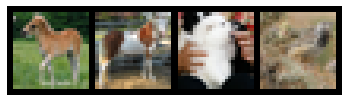

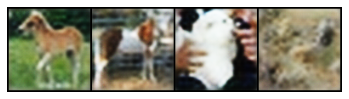

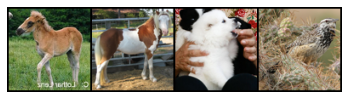

 39%|███▉      | 122/313 [00:08<00:12, 14.78it/s]

Step 2000: SRResNet loss: 0.02810


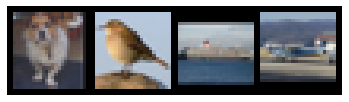

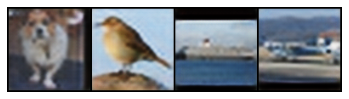

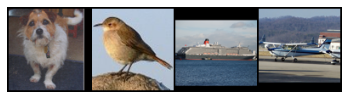

 58%|█████▊    | 182/313 [00:12<00:08, 14.98it/s]

Step 3000: SRResNet loss: 0.02607


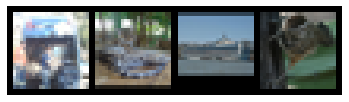

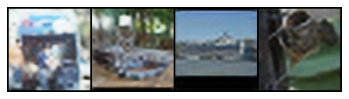

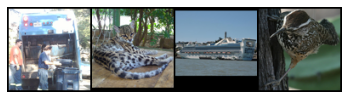

 78%|███████▊  | 244/313 [00:16<00:04, 14.49it/s]

Step 4000: SRResNet loss: 0.02494


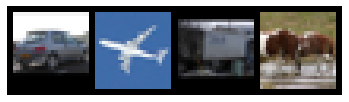

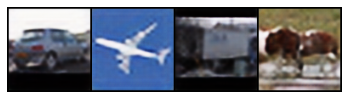

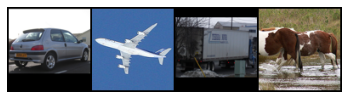

 97%|█████████▋| 304/313 [00:21<00:00, 14.82it/s]

Step 5000: SRResNet loss: 0.02421


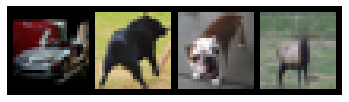

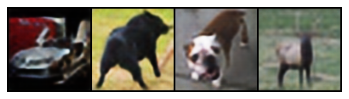

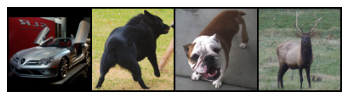

 17%|█▋        | 52/313 [00:03<00:17, 14.62it/s]

Step 6000: SRResNet loss: 0.02354


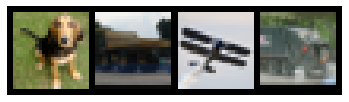

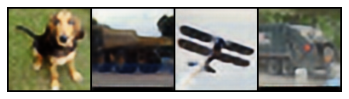

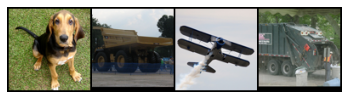

 36%|███▋      | 114/313 [00:07<00:13, 14.56it/s]

Step 7000: SRResNet loss: 0.02331


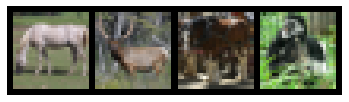

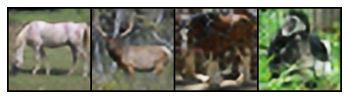

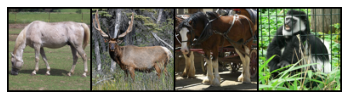

 56%|█████▌    | 174/313 [00:12<00:09, 14.35it/s]

Step 8000: SRResNet loss: 0.02291


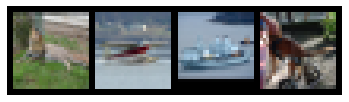

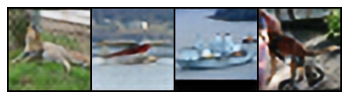

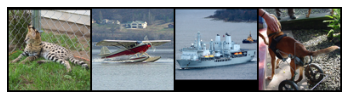

 75%|███████▌  | 236/313 [00:16<00:05, 14.69it/s]

Step 9000: SRResNet loss: 0.02266


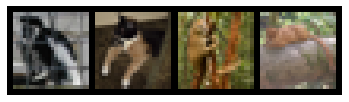

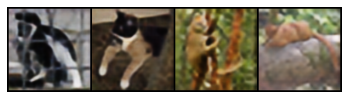

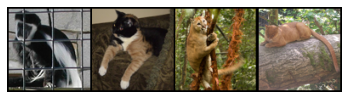

 95%|█████████▍| 296/313 [00:20<00:01, 14.65it/s]

Step 10000: SRResNet loss: 0.02243


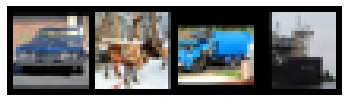

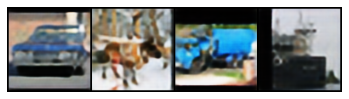

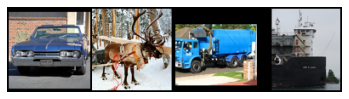

 14%|█▍        | 44/313 [00:03<00:18, 14.55it/s]

Step 11000: SRResNet loss: 0.02225


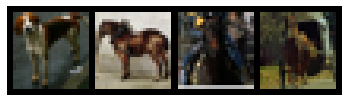

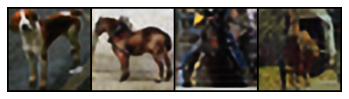

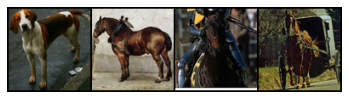

 34%|███▍      | 106/313 [00:07<00:14, 14.01it/s]

Step 12000: SRResNet loss: 0.02199


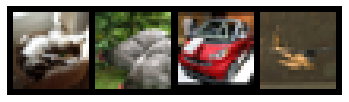

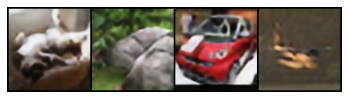

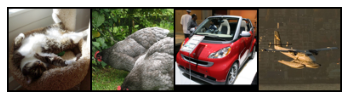

 53%|█████▎    | 166/313 [00:11<00:10, 14.12it/s]

Step 13000: SRResNet loss: 0.02191


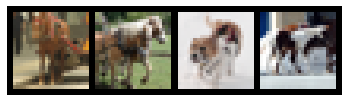

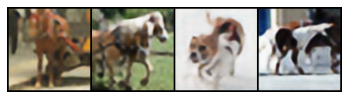

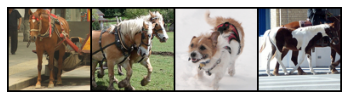

 73%|███████▎  | 228/313 [00:16<00:06, 14.13it/s]

Step 14000: SRResNet loss: 0.02170


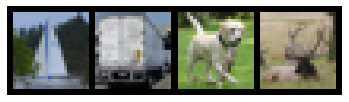

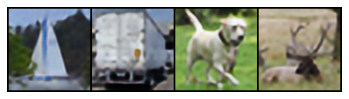

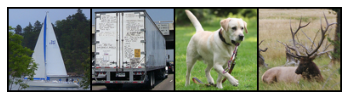

 92%|█████████▏| 288/313 [00:20<00:01, 13.90it/s]

Step 15000: SRResNet loss: 0.02164


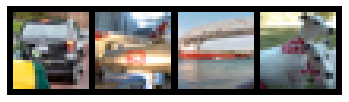

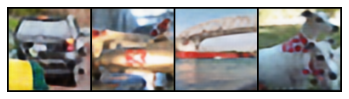

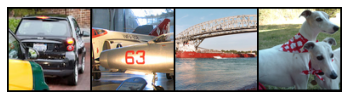

 12%|█▏        | 36/313 [00:02<00:19, 14.08it/s]

Step 16000: SRResNet loss: 0.02154


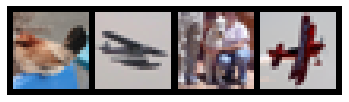

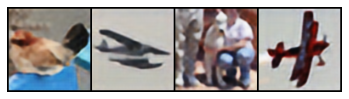

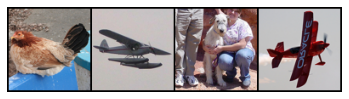

 31%|███▏      | 98/313 [00:06<00:15, 14.21it/s]

Step 17000: SRResNet loss: 0.02133


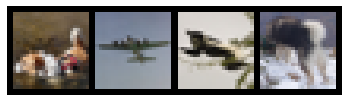

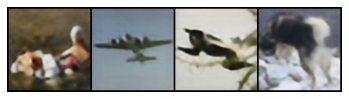

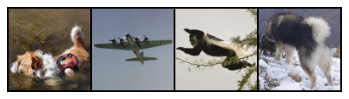

 50%|█████     | 158/313 [00:11<00:10, 14.33it/s]

Step 18000: SRResNet loss: 0.02127


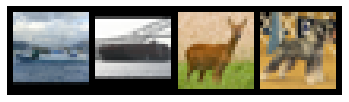

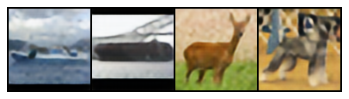

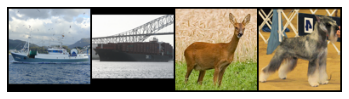

 70%|███████   | 220/313 [00:15<00:06, 13.90it/s]

Step 19000: SRResNet loss: 0.02120


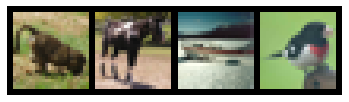

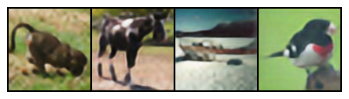

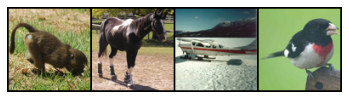

 89%|████████▉ | 280/313 [00:19<00:02, 13.91it/s]

Step 20000: SRResNet loss: 0.02111


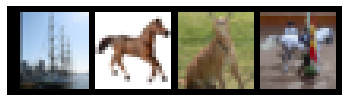

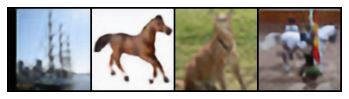

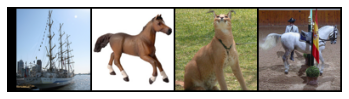

  9%|▉         | 28/313 [00:01<00:19, 14.38it/s]

Step 21000: SRResNet loss: 0.02109


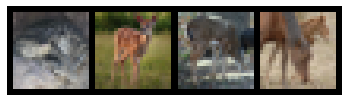

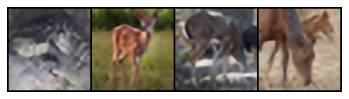

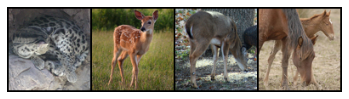

 29%|██▉       | 90/313 [00:06<00:15, 14.25it/s]

Step 22000: SRResNet loss: 0.02098


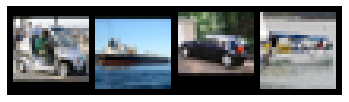

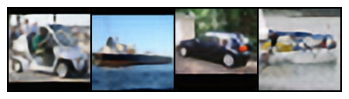

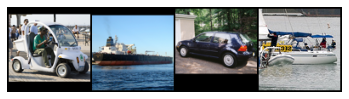

 48%|████▊     | 150/313 [00:10<00:11, 14.14it/s]

Step 23000: SRResNet loss: 0.02096


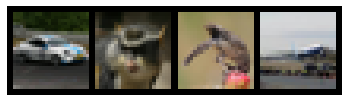

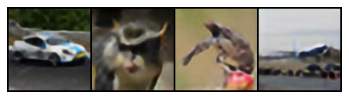

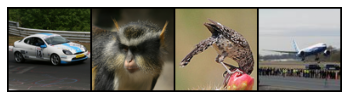

 68%|██████▊   | 212/313 [00:15<00:07, 13.98it/s]

Step 24000: SRResNet loss: 0.02078


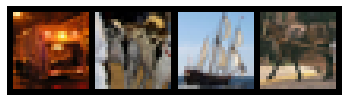

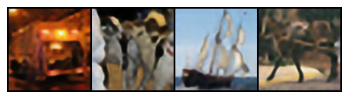

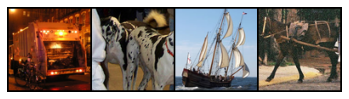

 87%|████████▋ | 272/313 [00:19<00:02, 13.74it/s]

Step 25000: SRResNet loss: 0.02091


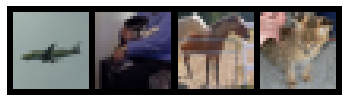

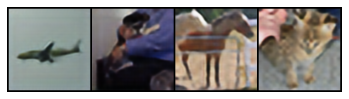

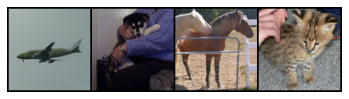

  6%|▋         | 20/313 [00:01<00:21, 13.93it/s]

Step 26000: SRResNet loss: 0.02081


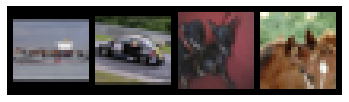

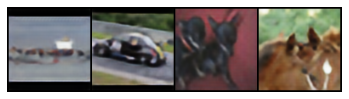

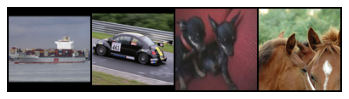

 26%|██▌       | 82/313 [00:05<00:17, 13.54it/s]

Step 27000: SRResNet loss: 0.02076


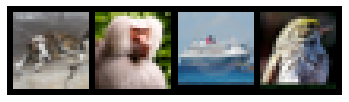

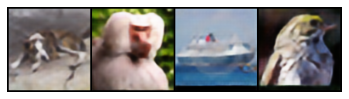

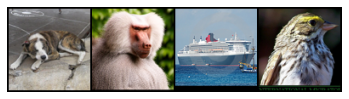

 45%|████▌     | 142/313 [00:10<00:12, 13.84it/s]

Step 28000: SRResNet loss: 0.02071


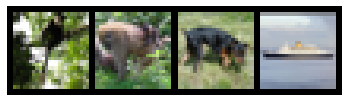

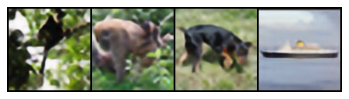

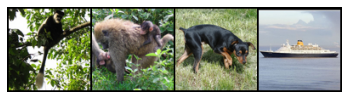

 65%|██████▌   | 204/313 [00:14<00:07, 13.89it/s]

Step 29000: SRResNet loss: 0.02068


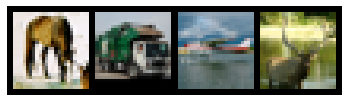

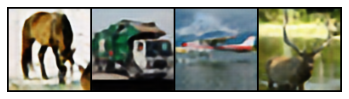

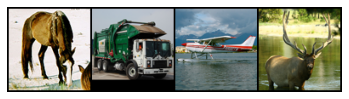

 84%|████████▍ | 264/313 [00:19<00:03, 14.02it/s]

Step 30000: SRResNet loss: 0.02061


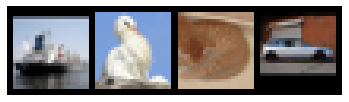

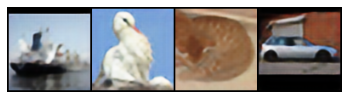

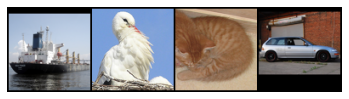

  4%|▍         | 12/313 [00:00<00:22, 13.39it/s]

Step 31000: SRResNet loss: 0.02054


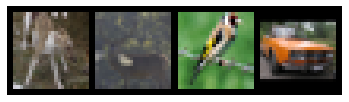

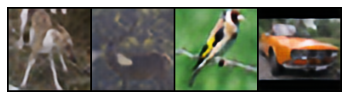

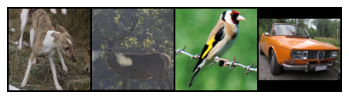

 24%|██▎       | 74/313 [00:05<00:17, 13.52it/s]

Step 32000: SRResNet loss: 0.02051


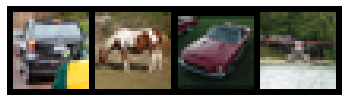

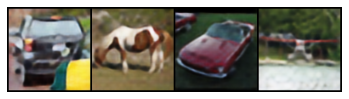

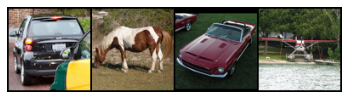

 43%|████▎     | 134/313 [00:09<00:12, 13.86it/s]

Step 33000: SRResNet loss: 0.02061


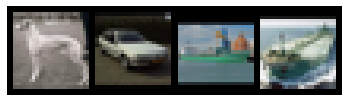

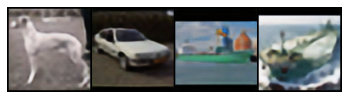

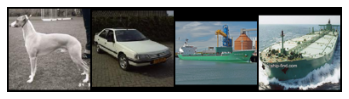

 63%|██████▎   | 196/313 [00:14<00:08, 13.88it/s]

Step 34000: SRResNet loss: 0.02044


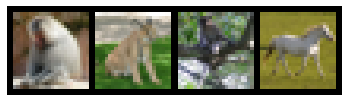

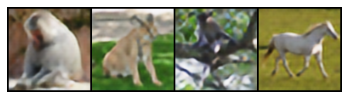

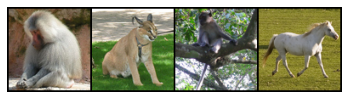

 82%|████████▏ | 256/313 [00:18<00:04, 13.71it/s]

Step 35000: SRResNet loss: 0.02042


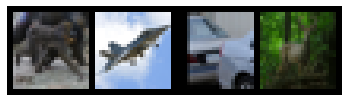

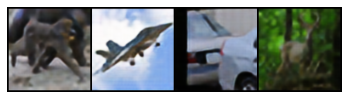

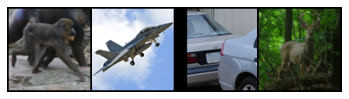

  1%|▏         | 4/313 [00:00<00:25, 12.08it/s]

Step 36000: SRResNet loss: 0.02040


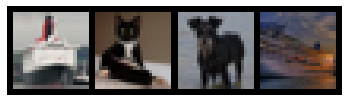

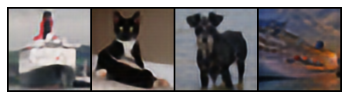

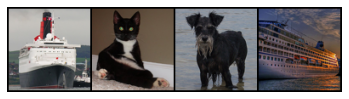

 21%|██        | 66/313 [00:04<00:17, 13.74it/s]

Step 37000: SRResNet loss: 0.02040


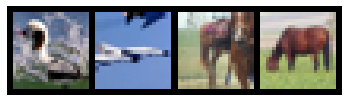

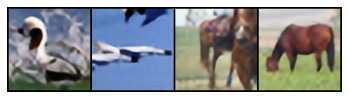

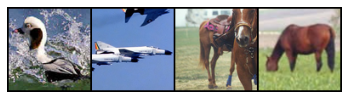

 40%|████      | 126/313 [00:09<00:13, 13.36it/s]

Step 38000: SRResNet loss: 0.02032


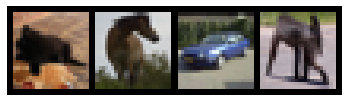

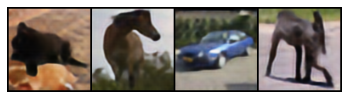

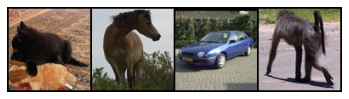

 60%|██████    | 188/313 [00:14<00:09, 13.44it/s]

Step 39000: SRResNet loss: 0.02041


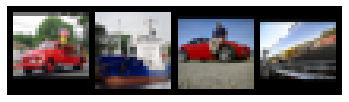

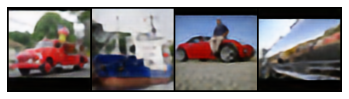

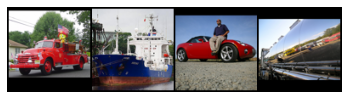

 79%|███████▉  | 248/313 [00:18<00:04, 13.03it/s]

Step 40000: SRResNet loss: 0.02036


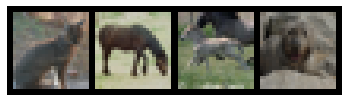

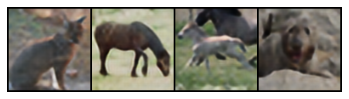

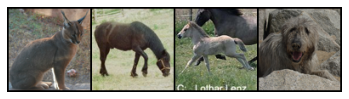

 99%|█████████▉| 310/313 [00:23<00:00, 13.37it/s]

Step 41000: SRResNet loss: 0.02041


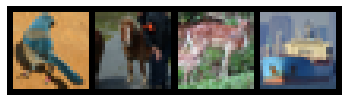

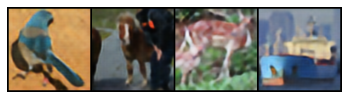

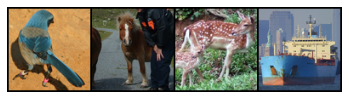

 19%|█▊        | 58/313 [00:04<00:19, 13.34it/s]

Step 42000: SRResNet loss: 0.02041


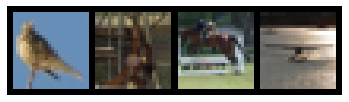

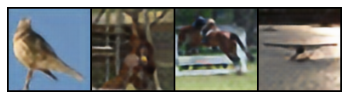

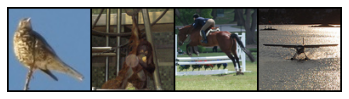

 38%|███▊      | 118/313 [00:09<00:14, 13.29it/s]

Step 43000: SRResNet loss: 0.02034


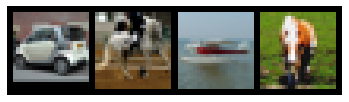

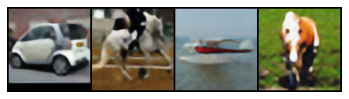

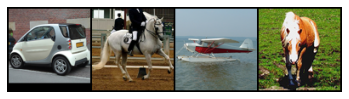

 58%|█████▊    | 180/313 [00:13<00:09, 13.33it/s]

Step 44000: SRResNet loss: 0.02045


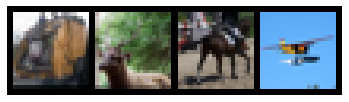

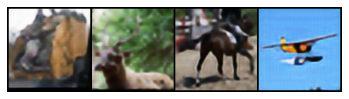

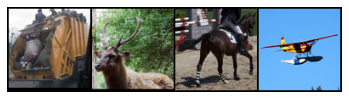

 77%|███████▋  | 240/313 [00:18<00:05, 13.20it/s]

Step 45000: SRResNet loss: 0.02048


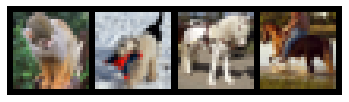

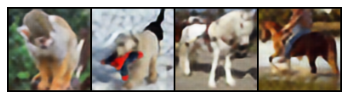

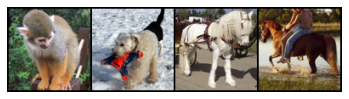

 96%|█████████▋| 302/313 [00:23<00:00, 13.16it/s]

Step 46000: SRResNet loss: 0.02056


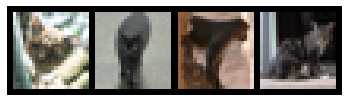

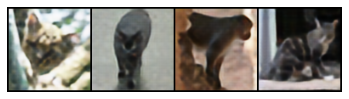

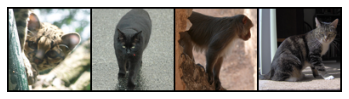

 16%|█▌        | 50/313 [00:03<00:20, 12.74it/s]

Step 47000: SRResNet loss: 0.02075


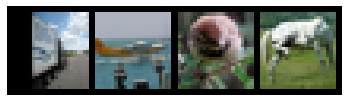

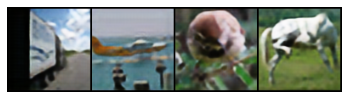

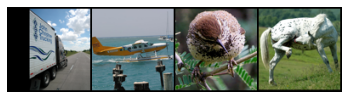

 35%|███▌      | 110/313 [00:08<00:15, 12.95it/s]

Step 48000: SRResNet loss: 0.02127


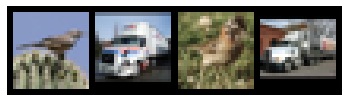

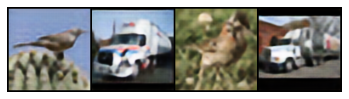

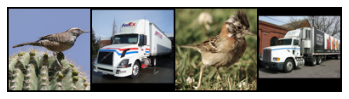

 55%|█████▍    | 172/313 [00:13<00:10, 12.93it/s]

Step 49000: SRResNet loss: 0.02181


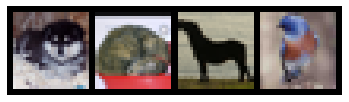

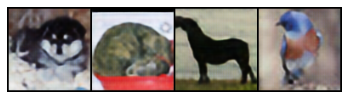

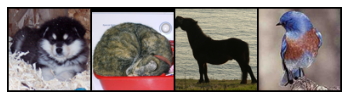

 74%|███████▍  | 232/313 [00:18<00:06, 12.80it/s]

Step 50000: SRResNet loss: 0.02371


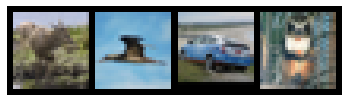

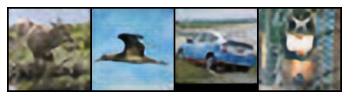

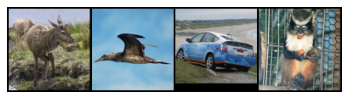

 94%|█████████▍| 294/313 [00:22<00:01, 13.06it/s]

Step 51000: SRResNet loss: 0.02514


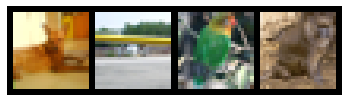

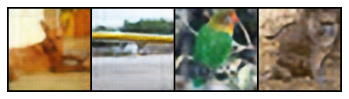

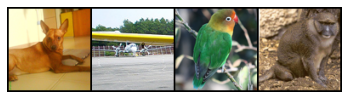

 13%|█▎        | 42/313 [00:03<00:21, 12.67it/s]

Step 52000: SRResNet loss: 0.02686


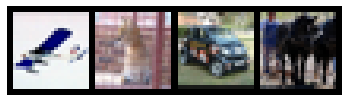

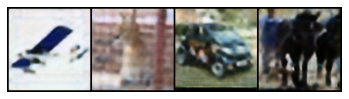

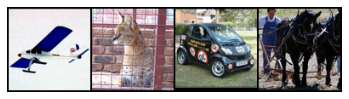

 33%|███▎      | 102/313 [00:08<00:16, 12.60it/s]

Step 53000: SRResNet loss: 0.02827


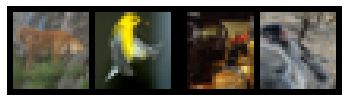

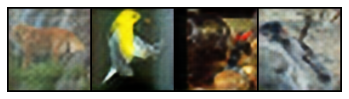

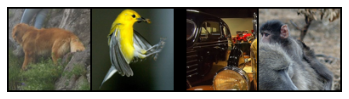

 52%|█████▏    | 164/313 [00:13<00:11, 12.71it/s]

Step 54000: SRResNet loss: 0.02909


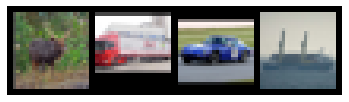

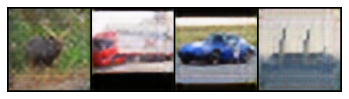

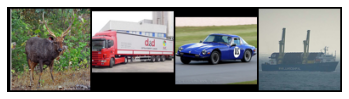

 72%|███████▏  | 224/313 [00:17<00:07, 12.55it/s]

Step 55000: SRResNet loss: 0.03024


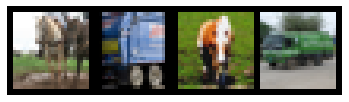

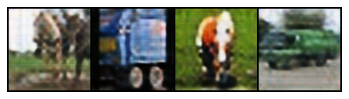

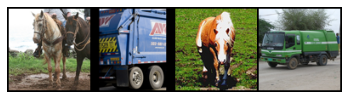

 91%|█████████▏| 286/313 [00:23<00:02, 12.51it/s]

Step 56000: SRResNet loss: 0.03095


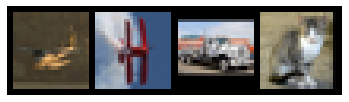

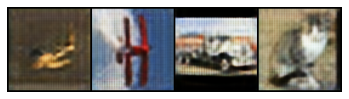

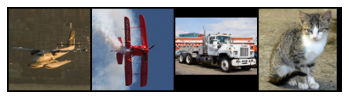

 11%|█         | 34/313 [00:02<00:22, 12.64it/s]

Step 57000: SRResNet loss: 0.03189


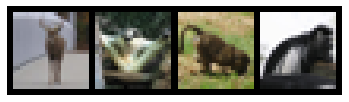

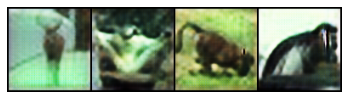

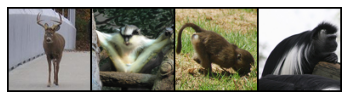

 30%|███       | 94/313 [00:07<00:17, 12.73it/s]

Step 58000: SRResNet loss: 0.03910


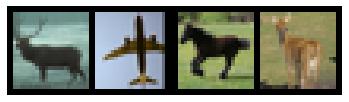

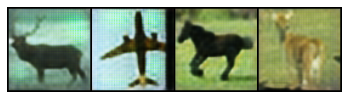

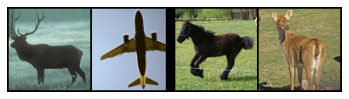

 50%|████▉     | 156/313 [00:12<00:12, 12.60it/s]

Step 59000: SRResNet loss: 0.06098


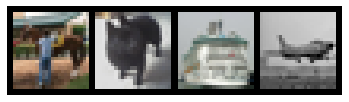

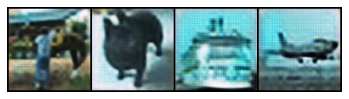

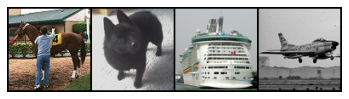

 69%|██████▉   | 216/313 [00:17<00:07, 12.35it/s]

Step 60000: SRResNet loss: 0.05737


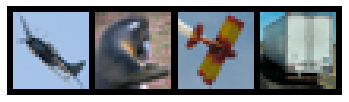

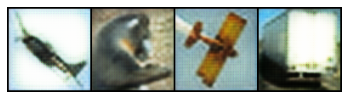

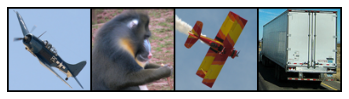

 89%|████████▉ | 278/313 [00:22<00:02, 12.46it/s]

Step 61000: SRResNet loss: 0.04987


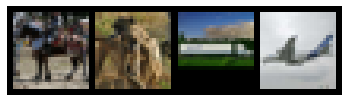

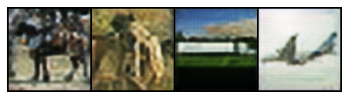

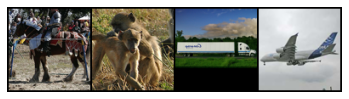

  8%|▊         | 26/313 [00:02<00:23, 12.19it/s]

Step 62000: SRResNet loss: 0.04704


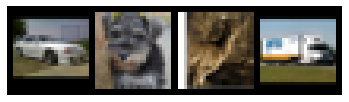

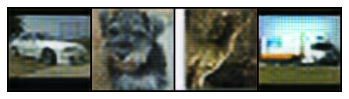

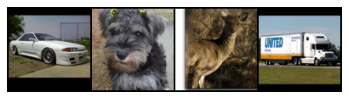

 27%|██▋       | 86/313 [00:06<00:18, 12.35it/s]

Step 63000: SRResNet loss: 0.03401


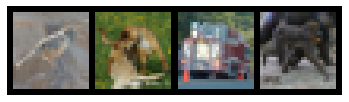

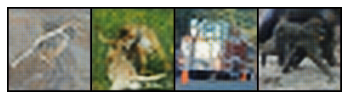

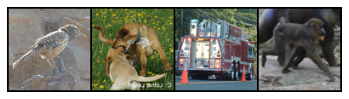

 47%|████▋     | 148/313 [00:11<00:13, 12.36it/s]

Step 64000: SRResNet loss: 0.03068


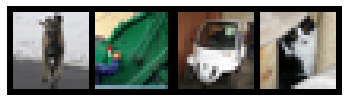

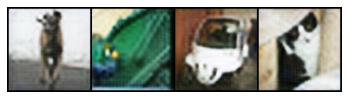

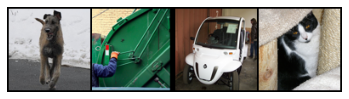

 66%|██████▋   | 208/313 [00:16<00:08, 12.27it/s]

Step 65000: SRResNet loss: 0.02885


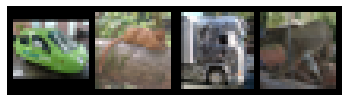

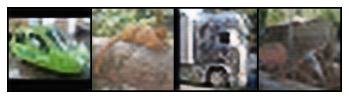

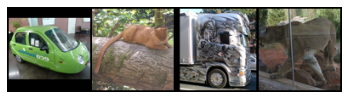

 86%|████████▋ | 270/313 [00:21<00:03, 12.58it/s]

Step 66000: SRResNet loss: 0.02832


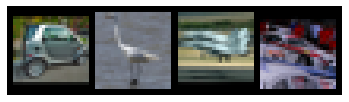

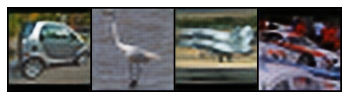

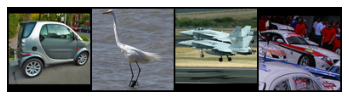

  6%|▌         | 18/313 [00:01<00:24, 11.89it/s]

Step 67000: SRResNet loss: 0.02801


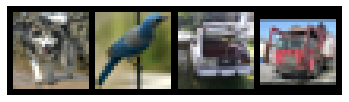

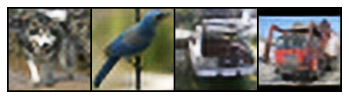

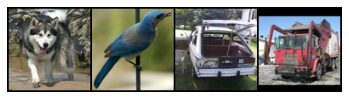

 25%|██▍       | 78/313 [00:06<00:19, 12.37it/s]

Step 68000: SRResNet loss: 0.02666


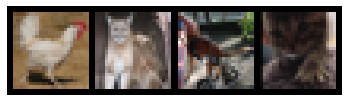

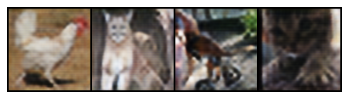

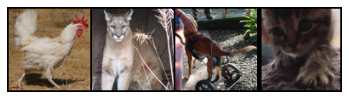

 45%|████▍     | 140/313 [00:11<00:13, 12.68it/s]

Step 69000: SRResNet loss: 0.02616


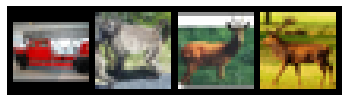

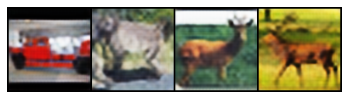

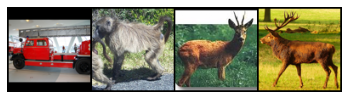

 64%|██████▍   | 200/313 [00:16<00:09, 12.44it/s]

Step 70000: SRResNet loss: 0.02478


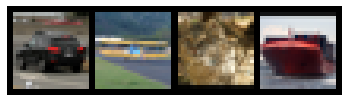

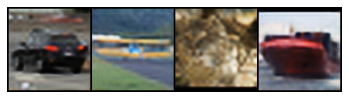

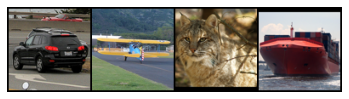

 84%|████████▎ | 262/313 [00:21<00:04, 12.43it/s]

Step 71000: SRResNet loss: 0.02464


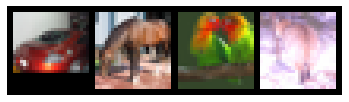

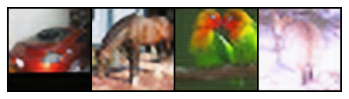

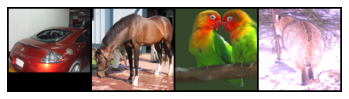

  3%|▎         | 10/313 [00:00<00:25, 11.75it/s]

Step 72000: SRResNet loss: 0.02387


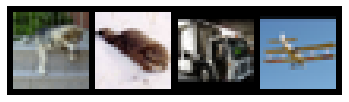

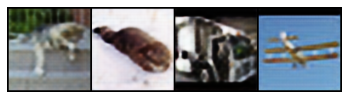

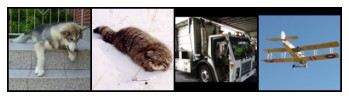

 22%|██▏       | 70/313 [00:05<00:19, 12.46it/s]

Step 73000: SRResNet loss: 0.02358


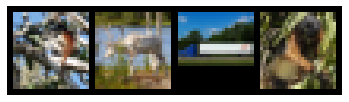

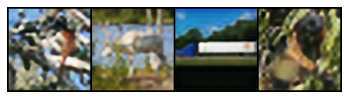

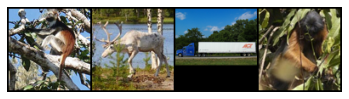

 42%|████▏     | 132/313 [00:10<00:14, 12.13it/s]

Step 74000: SRResNet loss: 0.02339


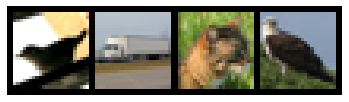

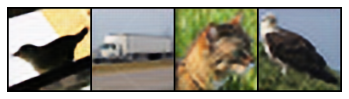

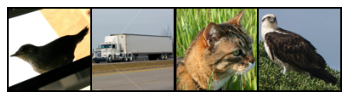

 61%|██████▏   | 192/313 [00:15<00:09, 12.42it/s]

Step 75000: SRResNet loss: 0.02330


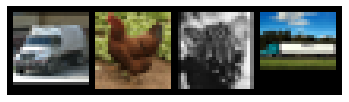

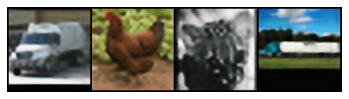

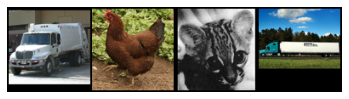

 81%|████████  | 254/313 [00:20<00:04, 12.45it/s]

Step 76000: SRResNet loss: 0.02320


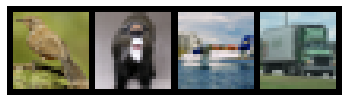

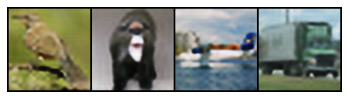

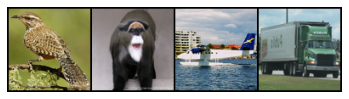

  1%|          | 2/313 [00:00<00:24, 12.50it/s]

Step 77000: SRResNet loss: 0.02293


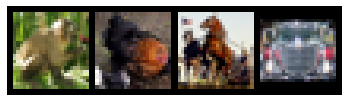

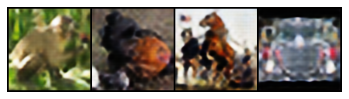

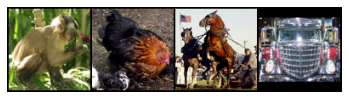

 20%|█▉        | 62/313 [00:05<00:20, 12.37it/s]

Step 78000: SRResNet loss: 0.02281


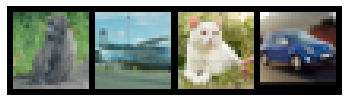

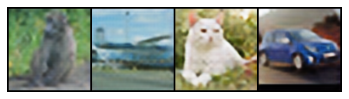

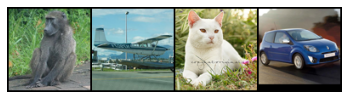

 40%|███▉      | 124/313 [00:10<00:15, 12.25it/s]

Step 79000: SRResNet loss: 0.02267


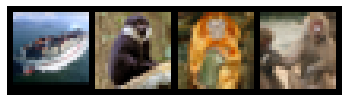

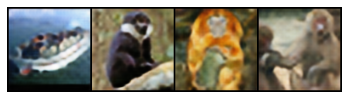

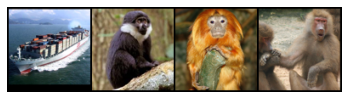

 59%|█████▉    | 184/313 [00:15<00:10, 12.24it/s]

Step 80000: SRResNet loss: 0.02245


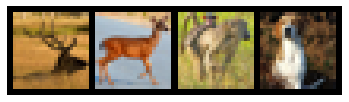

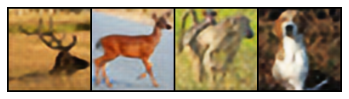

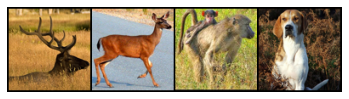

 79%|███████▊  | 246/313 [00:20<00:05, 12.08it/s]

Step 81000: SRResNet loss: 0.02240


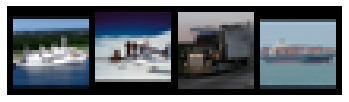

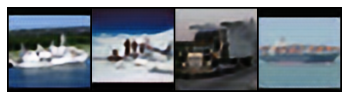

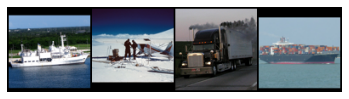

 98%|█████████▊| 306/313 [00:25<00:00, 11.88it/s]

Step 82000: SRResNet loss: 0.02231


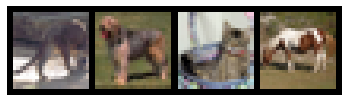

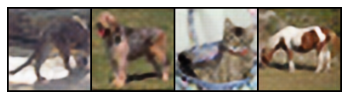

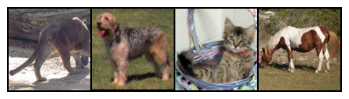

 17%|█▋        | 54/313 [00:04<00:21, 11.85it/s]

Step 83000: SRResNet loss: 0.02232


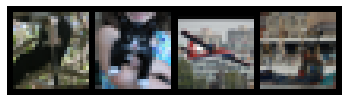

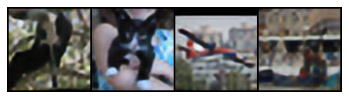

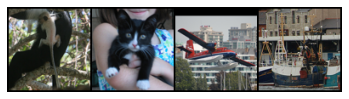

 37%|███▋      | 116/313 [00:09<00:16, 12.08it/s]

Step 84000: SRResNet loss: 0.02225


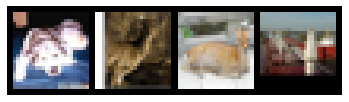

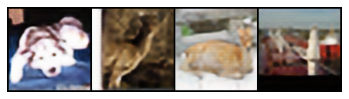

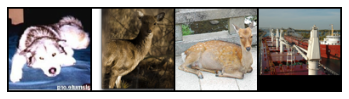

 56%|█████▌    | 176/313 [00:14<00:11, 11.99it/s]

Step 85000: SRResNet loss: 0.02200


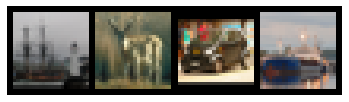

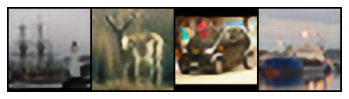

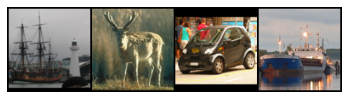

 76%|███████▌  | 238/313 [00:20<00:06, 11.92it/s]

Step 86000: SRResNet loss: 0.02202


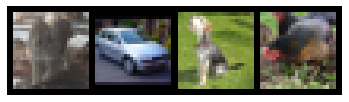

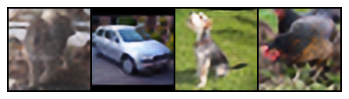

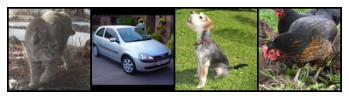

 95%|█████████▌| 298/313 [00:25<00:01, 11.81it/s]

Step 87000: SRResNet loss: 0.02200


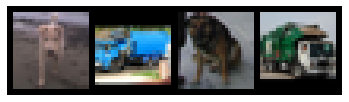

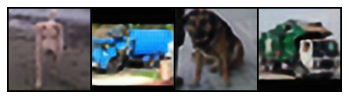

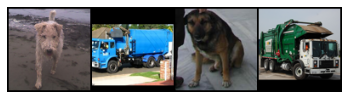

 15%|█▍        | 46/313 [00:03<00:22, 11.99it/s]

Step 88000: SRResNet loss: 0.02197


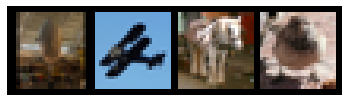

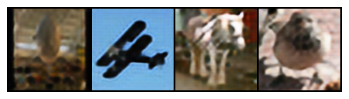

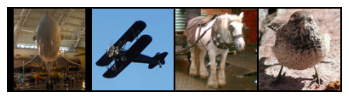

 35%|███▍      | 108/313 [00:09<00:17, 11.96it/s]

Step 89000: SRResNet loss: 0.02190


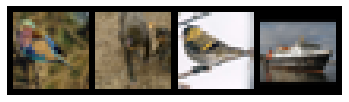

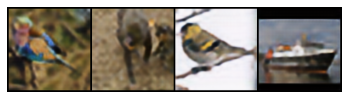

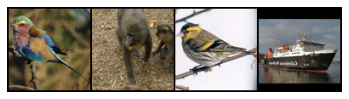

 54%|█████▎    | 168/313 [00:14<00:11, 12.19it/s]

Step 90000: SRResNet loss: 0.02179


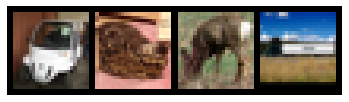

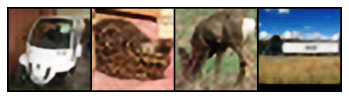

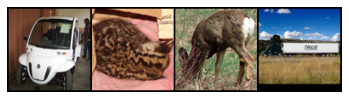

 73%|███████▎  | 230/313 [00:19<00:07, 11.74it/s]

Step 91000: SRResNet loss: 0.02174


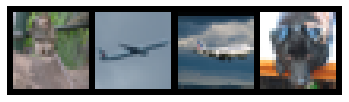

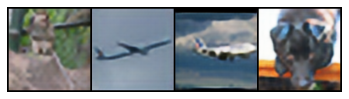

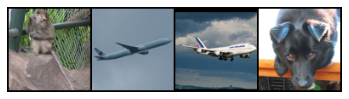

 93%|█████████▎| 290/313 [00:24<00:01, 11.87it/s]

Step 92000: SRResNet loss: 0.02188


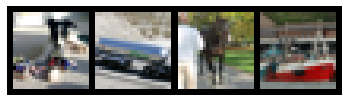

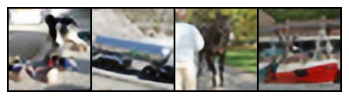

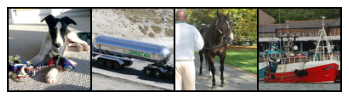

 12%|█▏        | 38/313 [00:03<00:23, 11.95it/s]

Step 93000: SRResNet loss: 0.02182


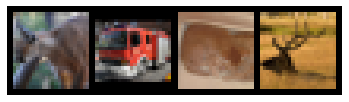

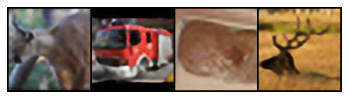

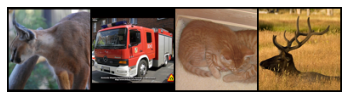

 32%|███▏      | 100/313 [00:08<00:18, 11.80it/s]

Step 94000: SRResNet loss: 0.02169


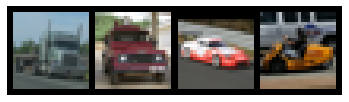

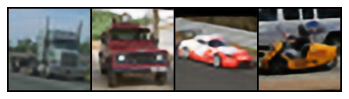

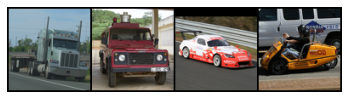

 51%|█████     | 160/313 [00:13<00:13, 11.63it/s]

Step 95000: SRResNet loss: 0.02177


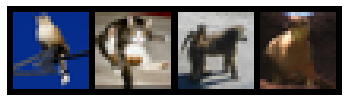

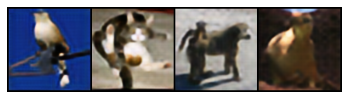

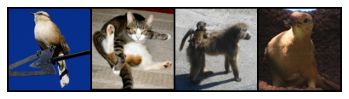

 71%|███████   | 222/313 [00:18<00:07, 11.82it/s]

Step 96000: SRResNet loss: 0.02172


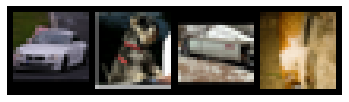

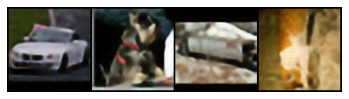

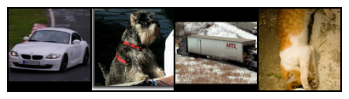

 90%|█████████ | 282/313 [00:24<00:02, 11.74it/s]

Step 97000: SRResNet loss: 0.02169


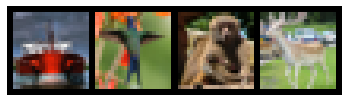

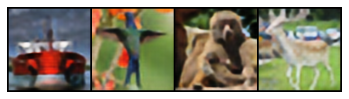

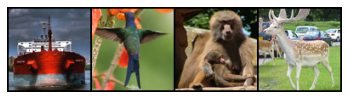

 10%|▉         | 30/313 [00:02<00:24, 11.78it/s]

Step 98000: SRResNet loss: 0.02167


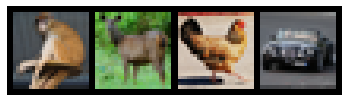

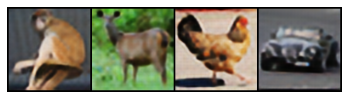

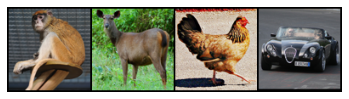

 29%|██▉       | 92/313 [00:07<00:18, 11.83it/s]

Step 99000: SRResNet loss: 0.02177


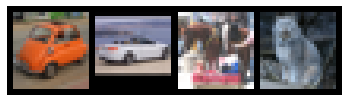

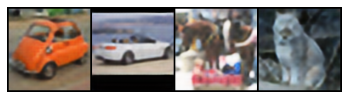

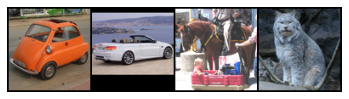

 49%|████▊     | 152/313 [00:12<00:13, 11.69it/s]


In [7]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
generator = Generator(n_res_blocks=16, n_ps_blocks=2)

# Uncomment the following lines if you're using ImageNet
# dataloader = torch.utils.data.DataLoader(
#     Dataset('data', 'train', download=True, hr_size=[384, 384], lr_size=[96, 96]),
#     batch_size=16, pin_memory=True, shuffle=True,
# )
# train_srresnet(generator, dataloader, device, lr=1e-4, total_steps=1e6, display_step=500)
# torch.save(generator, 'srresnet.pt')

# Uncomment the following lines if you're using STL
dataloader = torch.utils.data.DataLoader(
    Dataset('data', 'train', download=True, hr_size=[96, 96], lr_size=[24, 24]),
    batch_size=16, pin_memory=True, shuffle=True,
)
train_srresnet(generator, dataloader, device, lr=1e-4, total_steps=1e5, display_step=1000)
torch.save(generator, 'srresnet.pt')

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

 19%|█▉        | 61/313 [00:06<00:27,  9.20it/s]

Step 1000: Generator loss: 0.02692, Discriminator loss: 0.69055


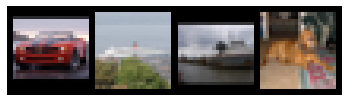

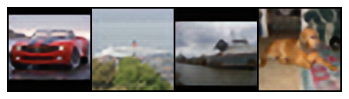

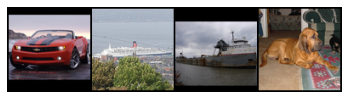

 39%|███▉      | 122/313 [00:13<00:20,  9.13it/s]

Step 2000: Generator loss: 0.02683, Discriminator loss: 0.67599


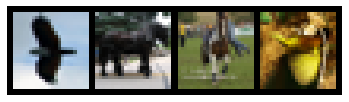

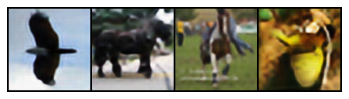

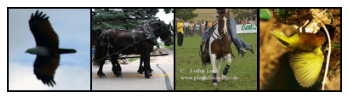

 58%|█████▊    | 183/313 [00:20<00:14,  9.03it/s]

Step 3000: Generator loss: 0.02688, Discriminator loss: 0.65166


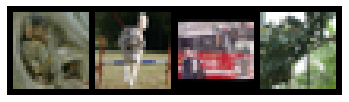

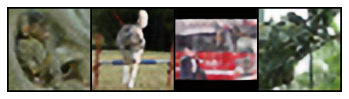

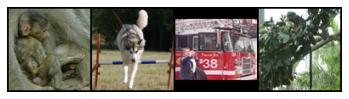

 78%|███████▊  | 244/313 [00:27<00:07,  8.80it/s]

Step 4000: Generator loss: 0.02677, Discriminator loss: 0.62503


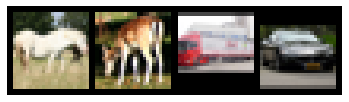

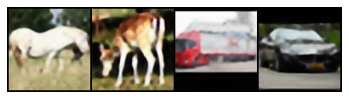

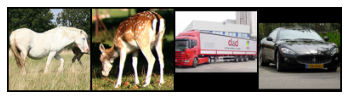

 97%|█████████▋| 305/313 [00:34<00:00,  8.61it/s]

Step 5000: Generator loss: 0.02671, Discriminator loss: 0.59680


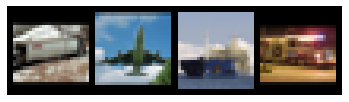

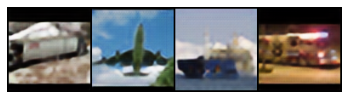

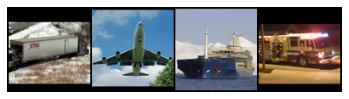

 17%|█▋        | 53/313 [00:06<00:29,  8.79it/s]

Step 6000: Generator loss: 0.02674, Discriminator loss: 0.56698


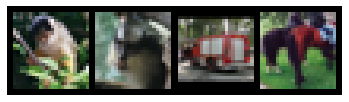

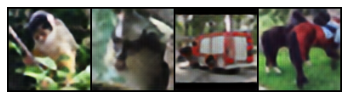

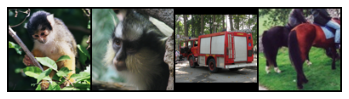

 36%|███▋      | 114/313 [00:13<00:22,  8.75it/s]

Step 7000: Generator loss: 0.02670, Discriminator loss: 0.53545


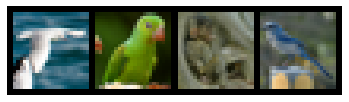

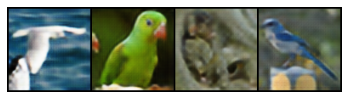

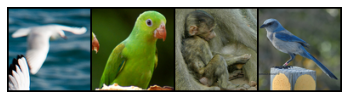

 56%|█████▌    | 175/313 [00:20<00:16,  8.48it/s]

Step 8000: Generator loss: 0.02663, Discriminator loss: 0.50104


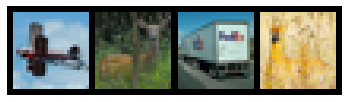

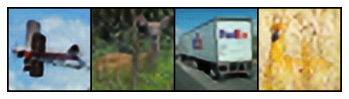

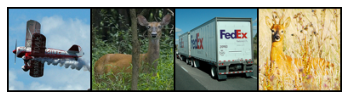

 75%|███████▌  | 236/313 [00:27<00:08,  8.79it/s]

Step 9000: Generator loss: 0.02662, Discriminator loss: 0.46334


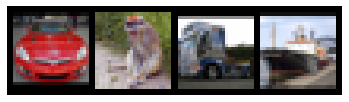

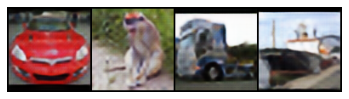

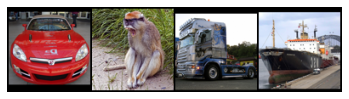

 95%|█████████▍| 297/313 [00:34<00:01,  8.53it/s]

Step 10000: Generator loss: 0.02663, Discriminator loss: 0.42376


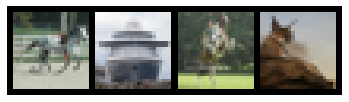

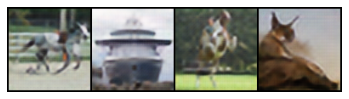

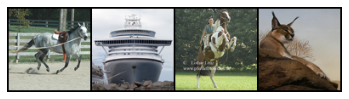

 14%|█▍        | 45/313 [00:05<00:31,  8.57it/s]

Step 11000: Generator loss: 0.02656, Discriminator loss: 0.38334


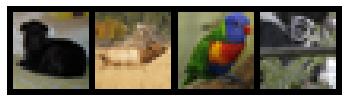

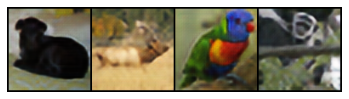

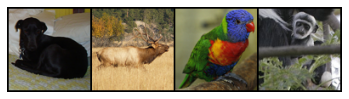

 34%|███▍      | 106/313 [00:12<00:24,  8.47it/s]

Step 12000: Generator loss: 0.02650, Discriminator loss: 0.34401


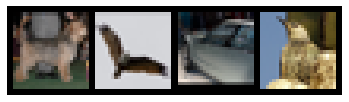

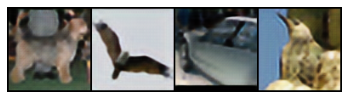

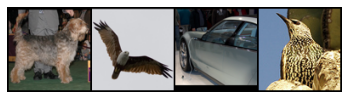

 53%|█████▎    | 167/313 [00:19<00:17,  8.52it/s]

Step 13000: Generator loss: 0.02662, Discriminator loss: 0.30596


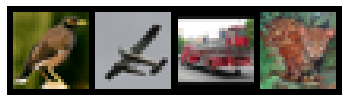

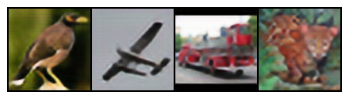

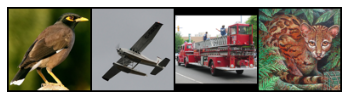

 73%|███████▎  | 228/313 [00:27<00:10,  7.99it/s]

Step 14000: Generator loss: 0.02645, Discriminator loss: 0.26845


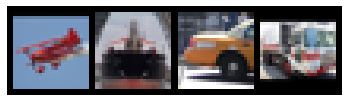

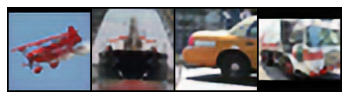

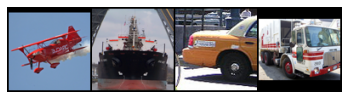

 92%|█████████▏| 289/313 [00:34<00:02,  8.36it/s]

Step 15000: Generator loss: 0.02643, Discriminator loss: 0.23404


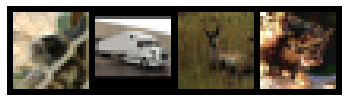

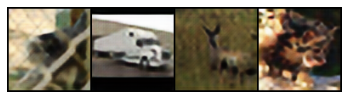

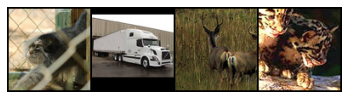

 12%|█▏        | 37/313 [00:04<00:33,  8.23it/s]

Step 16000: Generator loss: 0.02640, Discriminator loss: 0.20194


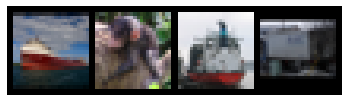

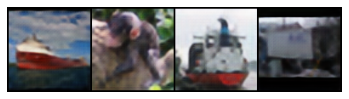

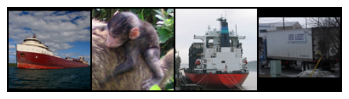

 31%|███▏      | 98/313 [00:11<00:25,  8.36it/s]

Step 17000: Generator loss: 0.02645, Discriminator loss: 0.17274


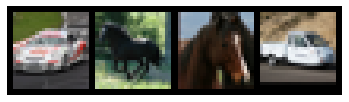

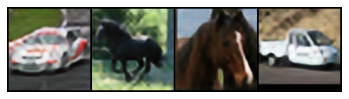

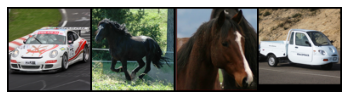

 51%|█████     | 159/313 [00:19<00:18,  8.44it/s]

Step 18000: Generator loss: 0.02633, Discriminator loss: 0.14632


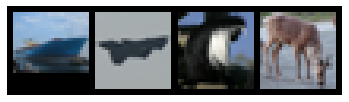

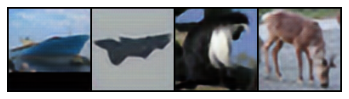

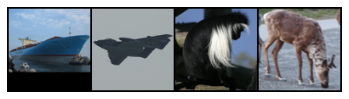

 70%|███████   | 220/313 [00:26<00:11,  8.38it/s]

Step 19000: Generator loss: 0.02646, Discriminator loss: 0.12330


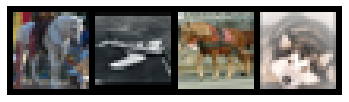

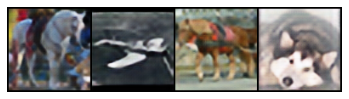

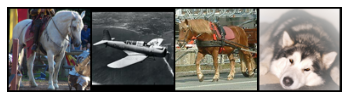

 90%|████████▉ | 281/313 [00:33<00:03,  8.33it/s]

Step 20000: Generator loss: 0.02631, Discriminator loss: 0.10280


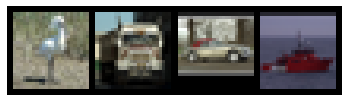

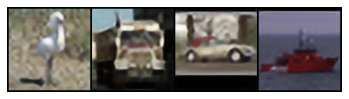

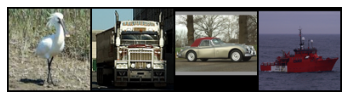

  9%|▉         | 29/313 [00:03<00:34,  8.16it/s]

Step 21000: Generator loss: 0.02636, Discriminator loss: 0.08529


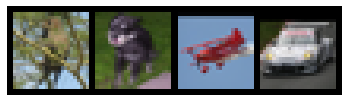

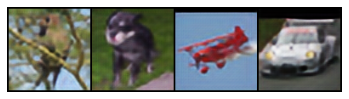

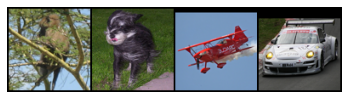

 29%|██▉       | 90/313 [00:10<00:26,  8.29it/s]

Step 22000: Generator loss: 0.02635, Discriminator loss: 0.07029


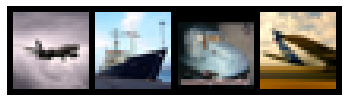

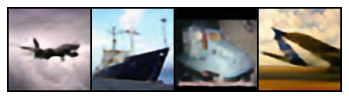

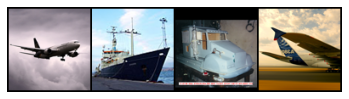

 48%|████▊     | 151/313 [00:18<00:19,  8.30it/s]

Step 23000: Generator loss: 0.02641, Discriminator loss: 0.05749


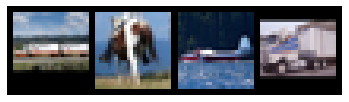

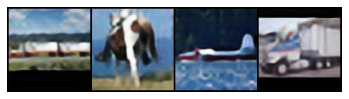

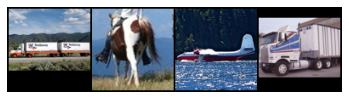

 68%|██████▊   | 212/313 [00:25<00:12,  8.36it/s]

Step 24000: Generator loss: 0.02625, Discriminator loss: 0.04660


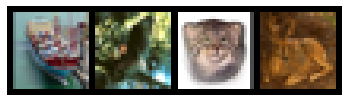

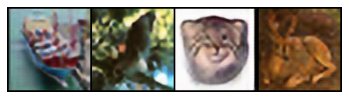

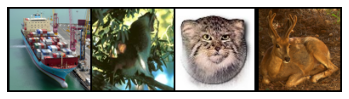

 87%|████████▋ | 273/313 [00:33<00:04,  8.10it/s]

Step 25000: Generator loss: 0.02636, Discriminator loss: 0.03759


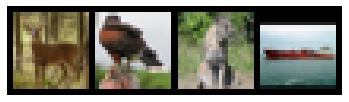

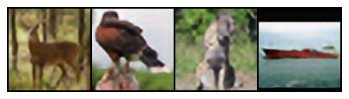

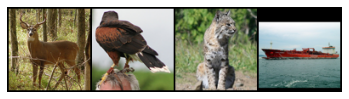

  7%|▋         | 21/313 [00:02<00:35,  8.15it/s]

Step 26000: Generator loss: 0.02636, Discriminator loss: 0.03041


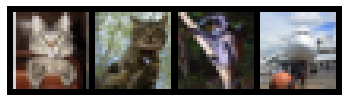

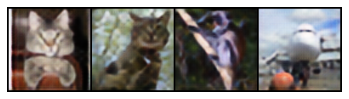

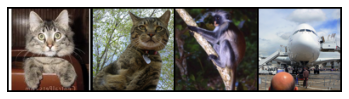

 26%|██▌       | 82/313 [00:09<00:27,  8.37it/s]

Step 27000: Generator loss: 0.02630, Discriminator loss: 0.02442


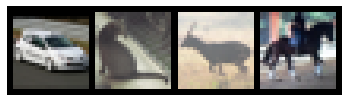

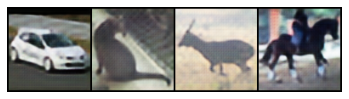

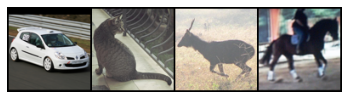

 46%|████▌     | 143/313 [00:17<00:20,  8.32it/s]

Step 28000: Generator loss: 0.02635, Discriminator loss: 0.01956


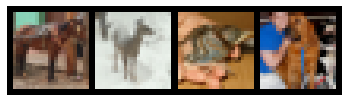

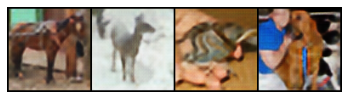

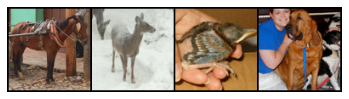

 65%|██████▌   | 204/313 [00:24<00:13,  8.17it/s]

Step 29000: Generator loss: 0.02639, Discriminator loss: 0.01535


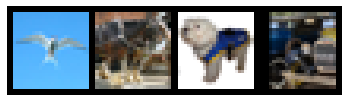

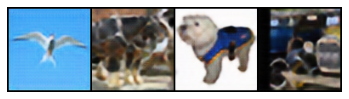

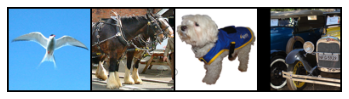

 85%|████████▍ | 265/313 [00:31<00:05,  8.19it/s]

Step 30000: Generator loss: 0.02630, Discriminator loss: 0.01213


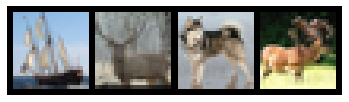

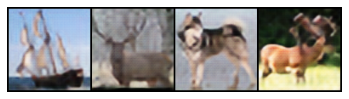

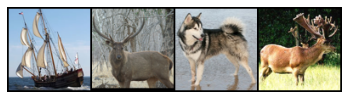

  4%|▍         | 13/313 [00:01<00:36,  8.21it/s]

Step 31000: Generator loss: 0.02638, Discriminator loss: 0.00964


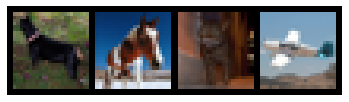

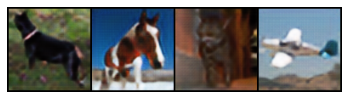

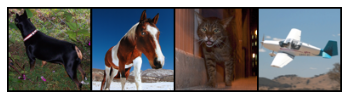

 24%|██▎       | 74/313 [00:08<00:28,  8.38it/s]

Step 32000: Generator loss: 0.02632, Discriminator loss: 0.00744


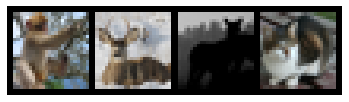

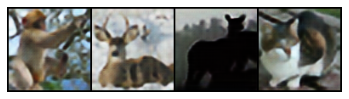

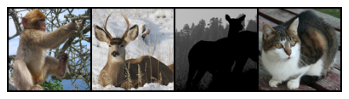

 43%|████▎     | 135/313 [00:16<00:21,  8.21it/s]

Step 33000: Generator loss: 0.02643, Discriminator loss: 0.00602


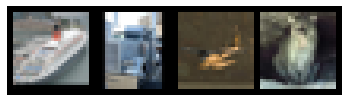

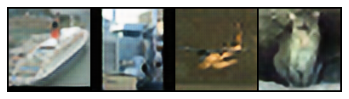

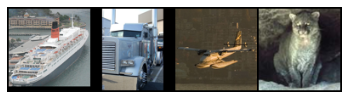

 63%|██████▎   | 196/313 [00:23<00:13,  8.39it/s]

Step 34000: Generator loss: 0.02632, Discriminator loss: 0.00466


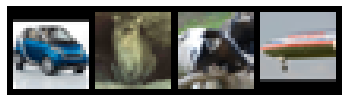

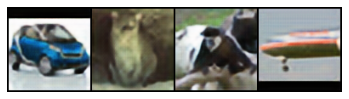

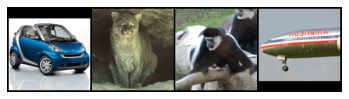

 82%|████████▏ | 257/313 [00:31<00:06,  8.20it/s]

Step 35000: Generator loss: 0.02640, Discriminator loss: 0.00362


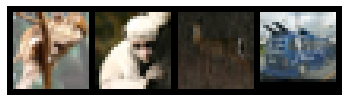

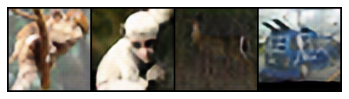

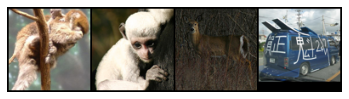

  2%|▏         | 5/313 [00:00<00:38,  7.91it/s]

Step 36000: Generator loss: 0.02637, Discriminator loss: 0.00283


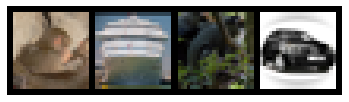

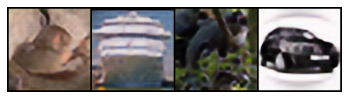

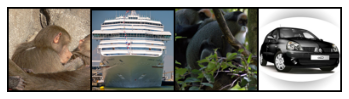

 21%|██        | 66/313 [00:07<00:29,  8.31it/s]

Step 37000: Generator loss: 0.02633, Discriminator loss: 0.00216


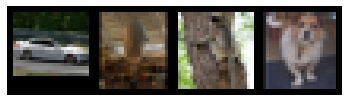

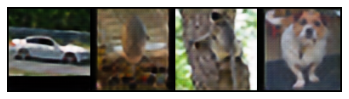

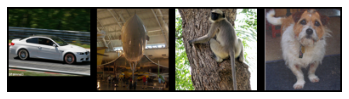

 41%|████      | 127/313 [00:15<00:22,  8.22it/s]

Step 38000: Generator loss: 0.02632, Discriminator loss: 0.00168


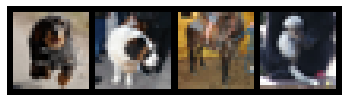

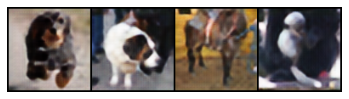

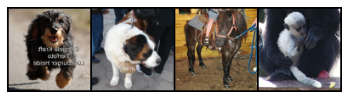

 60%|██████    | 188/313 [00:22<00:15,  8.32it/s]

Step 39000: Generator loss: 0.02638, Discriminator loss: 0.00130


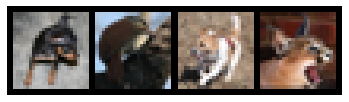

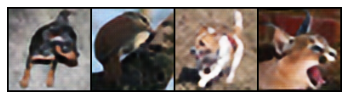

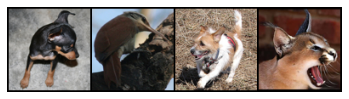

 80%|███████▉  | 249/313 [00:30<00:07,  8.24it/s]

Step 40000: Generator loss: 0.02640, Discriminator loss: 0.00104


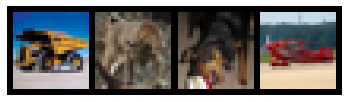

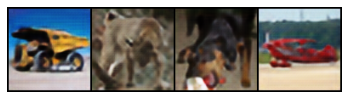

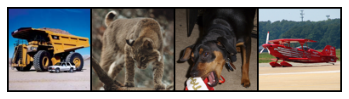

 99%|█████████▉| 310/313 [00:37<00:00,  8.23it/s]

Step 41000: Generator loss: 0.02643, Discriminator loss: 0.00079


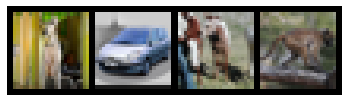

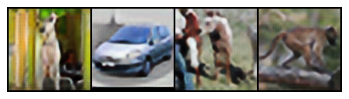

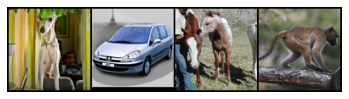

 19%|█▊        | 58/313 [00:07<00:30,  8.23it/s]

Step 42000: Generator loss: 0.02634, Discriminator loss: 0.00063


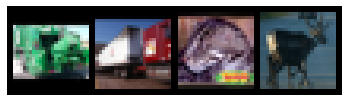

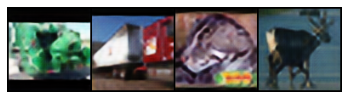

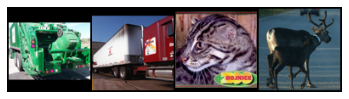

 38%|███▊      | 119/313 [00:14<00:24,  8.06it/s]

Step 43000: Generator loss: 0.02645, Discriminator loss: 0.00048


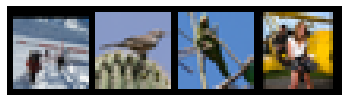

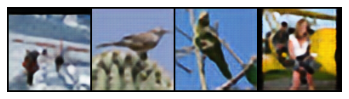

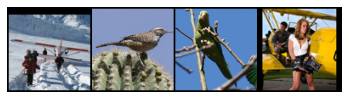

 58%|█████▊    | 180/313 [00:21<00:16,  8.08it/s]

Step 44000: Generator loss: 0.02633, Discriminator loss: 0.00036


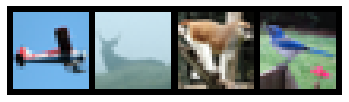

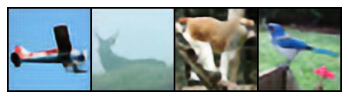

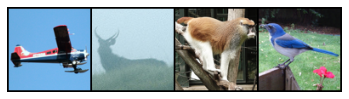

 77%|███████▋  | 241/313 [00:29<00:08,  8.21it/s]

Step 45000: Generator loss: 0.02638, Discriminator loss: 0.00029


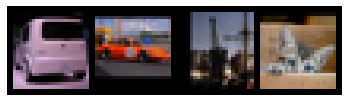

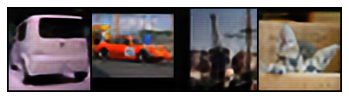

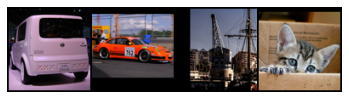

 96%|█████████▋| 302/313 [00:36<00:01,  8.32it/s]

Step 46000: Generator loss: 0.02647, Discriminator loss: 0.00023


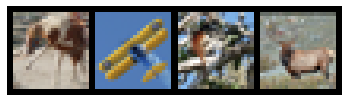

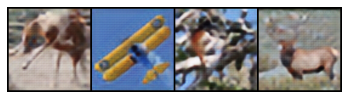

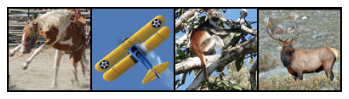

 78%|███████▊  | 244/313 [00:29<00:08,  8.24it/s]

In [ ]:
generator = torch.load('srresnet.pt')
discriminator = Discriminator(n_blocks=1, base_channels=8)

# Uncomment the following lines if you're using ImageNet
# train_srgan(generator, discriminator, dataloader, device, lr=1e-4, total_steps=2e5, display_step=500)
# torch.save(generator, 'srgenerator.pt')
# torch.save(discriminator, 'srdiscriminator.pt')

# Uncomment the following lines if you're using STL
train_srgan(generator, discriminator, dataloader, device, lr=1e-4, total_steps=2e5, display_step=1000)
torch.save(generator, 'srgenerator.pt')
torch.save(discriminator, 'srdiscriminator.pt')